# Advanced Computer Vision for AI - ARI3129

## Matthew Privitera - Object Detection using RF-DETR

Documentation for RF-DETR is found here: https://rfdetr.roboflow.com/

### Check GPU Availability (on Colab)

In [ ]:
!nvidia-smi

Sun Jan 18 18:02:01 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   64C    P8             11W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

### Install Dependencies

Installs RF-DETR version 1.2.1 or higher (which includes the new Nano, Small, and Medium checkpoints), along with Supervision for benchmarking.

In [ ]:
!pip install -q rfdetr==1.2.1 supervision==0.26.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 266.3/266.3 kB 11.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 131.3/131.3 kB 14.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.2/207.2 kB 21.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 71.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 372.8/372.8 kB 36.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.7/91.7 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 17.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 90.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 138.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━

### Import Dataset from Google Drive

In [ ]:
from google.colab import drive

drive.mount('/content/drive') # Mounting drive

Mounted at /content/drive


Copying entire dataset from Drive to the fast local SSD of the colab instance.

In [ ]:
!rm -rf /content/dataset
!mkdir -p /content/dataset
!cp -r "/content/drive/MyDrive/Colab Notebooks/COCO-based_COCO"/* /content/dataset/

In [ ]:
!ls /content/dataset/

test  train  valid


### Train RF-DETR on custom dataset

RF-DETR library expects every entry in the "categories" section of the COCO JSON file to have a field called "supercategory", the files are missing it. The code below gives a supercategory to all categories called "traffic_sign".

Another issue occurs with how CUDA interacts with the catrgory IDs. In the current JSON, the IDs range from 1 to 6. When the model trains, it creates a "head" with 6 slots (0-5). When the GPU encounters a sign with `category_id: 6`, it tries to put it in the 7th slot, which doesn't exist.

In [ ]:
import json
import os

# Path to unzipped dataset in Colab
dataset_path = "/content/dataset"
splits = ['train', 'valid', 'test']

for split in splits:
    json_path = os.path.join(dataset_path, split, "_annotations.coco.json")

    if os.path.exists(json_path):
        with open(json_path, 'r') as f:
            data = json.load(f)

        # Fix Categories: Add supercategory AND shift ID (1 -> 0)
        for cat in data['categories']:
            cat['supercategory'] = 'traffic_sign'
            cat['id'] = cat['id'] - 1  # Shift 1-indexed to 0-indexed

        # Fix Annotations: Shift category_id to match the new category IDs
        for ann in data['annotations']:
            ann['category_id'] = ann['category_id'] - 1

        # Save
        with open(json_path, 'w') as f:
            json.dump(data, f, indent=4)

        print(f"Successfully patched {split} annotations: Added supercategory & re-indexed to 0.")
    else:
        print(f"Warning: Could not find {json_path}")

Successfully patched train annotations: Added supercategory & re-indexed to 0.
Successfully patched valid annotations: Added supercategory & re-indexed to 0.
Successfully patched test annotations: Added supercategory & re-indexed to 0.


In [ ]:
%load_ext tensorboard
%tensorboard --logdir "/content/drive/MyDrive/Colab Notebooks/RFDETR_Maltese_Signs_Results"

<IPython.core.display.Javascript object>

In [ ]:
from rfdetr import RFDETRNano

model = RFDETRNano()

output_path = "/content/drive/MyDrive/Colab Notebooks/RFDETR_Maltese_Signs_Results"

model.train(
    dataset_dir = "/content/dataset/",
    epochs = 50,
    batch_size=4,
    grad_accum_steps = 4,
    lr=1e-4,
    lr_scheduler='cosine',
    lr_min_factor=0.01,
    early_stopping=True,
    early_stopping_patience=10,
    early_stopping_min_delta=0.001,
    checkpoint_interval=5,
    output_dir = output_path,
    val_interval = 1,
    weight_decay=0.0001,
    clip_max_norm=0.1
)

rf-detr-nano.pth: 100%|██████████| 349M/349M [00:04<00:00, 90.8MiB/s]


Using a different number of positional encodings than DINOv2, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Using patch size 16 instead of 14, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Loading pretrain weights


reinitializing your detection head with 6 classes.


TensorBoard logging initialized. To monitor logs, use 'tensorboard --logdir /content/drive/MyDrive/Colab Notebooks/RFDETR_Maltese_Signs_Results' and open http://localhost:6006/ in browser.
Not using distributed mode
git:
  sha: N/A, status: clean, branch: N/A

Namespace(num_classes=6, grad_accum_steps=4, amp=True, lr=0.0001, lr_encoder=0.00015, batch_size=4, weight_decay=0.0001, epochs=50, lr_drop=100, clip_max_norm=0.1, lr_vit_layer_decay=0.8, lr_component_decay=0.7, do_benchmark=False, dropout=0, drop_path=0.0, drop_mode='standard', drop_schedule='constant', cutoff_epoch=0, pretrained_encoder=None, pretrain_weights='rf-detr-nano.pth', pretrain_exclude_keys=None, pretrain_keys_modify_to_load=None, pretrained_distiller=None, encoder='dinov2_windowed_small', vit_encoder_num_layers=12, window_block_indexes=None, position_embedding='sine', out_feature_indexes=[3, 6, 9, 12], freeze_encoder=False, layer_norm=True, rms_norm=False, backbone_lora=False, force_no_pretrain=False, dec_layers=2, d

Epoch: [0]  [ 0/30]  eta: 0:06:53  lr: 0.000100  class_error: 90.38  loss: 5.3044 (5.3044)  loss_ce: 1.3442 (1.3442)  loss_bbox: 0.1953 (0.1953)  loss_giou: 0.1722 (0.1722)  loss_ce_0: 1.3675 (1.3675)  loss_bbox_0: 0.2130 (0.2130)  loss_giou_0: 0.1739 (0.1739)  loss_ce_enc: 1.3289 (1.3289)  loss_bbox_enc: 0.2859 (0.2859)  loss_giou_enc: 0.2236 (0.2236)  loss_ce_unscaled: 1.3442 (1.3442)  class_error_unscaled: 90.3846 (90.3846)  loss_bbox_unscaled: 0.0391 (0.0391)  loss_giou_unscaled: 0.0861 (0.0861)  cardinality_error_unscaled: 3381.0000 (3381.0000)  loss_ce_0_unscaled: 1.3675 (1.3675)  loss_bbox_0_unscaled: 0.0426 (0.0426)  loss_giou_0_unscaled: 0.0870 (0.0870)  cardinality_error_0_unscaled: 3060.5000 (3060.5000)  loss_ce_enc_unscaled: 1.3289 (1.3289)  loss_bbox_enc_unscaled: 0.0572 (0.0572)  loss_giou_enc_unscaled: 0.1118 (0.1118)  cardinality_error_enc_unscaled: 3542.2500 (3542.2500)  time: 13.7984  data: 5.6497  max mem: 2699
Epoch: [0]  [10/30]  eta: 0:01:24  lr: 0.000100  class_e

### Evaluate Fine-tuned RF-DETR Model

Before benchmarking the model, we need to load the best saved checkpoint. To ensure it fits on the GPU, we first need to free up GPU memory. This involves deleting any remaining references to previously used objects, triggering Python’s garbage collector, and clearing the CUDA memory cache.

In [ ]:
import gc
import torch
import weakref

def cleanup_gpu_memory(obj=None, verbose: bool = False):

    if not torch.cuda.is_available():
        if verbose:
            print("[INFO] CUDA is not available. No GPU cleanup needed.")
        return

    def get_memory_stats():
        allocated = torch.cuda.memory_allocated()
        reserved = torch.cuda.memory_reserved()
        return allocated, reserved

    torch.cuda.synchronize()

    if verbose:
        alloc, reserv = get_memory_stats()
        print(f"[Before] Allocated: {alloc / 1024**2:.2f} MB | Reserved: {reserv / 1024**2:.2f} MB")

    # Ensure we drop all strong references
    if obj is not None:
        ref = weakref.ref(obj)
        del obj
        if ref() is not None and verbose:
            print("[WARNING] Object not fully garbage collected yet.")

    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.ipc_collect()

    torch.cuda.synchronize()

    if verbose:
        alloc, reserv = get_memory_stats()
        print(f"[After]  Allocated: {alloc / 1024**2:.2f} MB | Reserved: {reserv / 1024**2:.2f} MB")

In [ ]:
cleanup_gpu_memory(model, verbose=True)

[Before] Allocated: 255.46 MB | Reserved: 4416.00 MB
[WARNING] Object not fully garbage collected yet.
[After]  Allocated: 255.46 MB | Reserved: 438.00 MB


### Load Model for Inference

We load the best-performing model from the `checkpoint_best_total.pth` file using the `RFDETRNano` class. This checkpoint contains the trained weights from our most successful training run. After loading, we call `optimize_for_inference()`, which prepares the model for efficient inference.

In [ ]:
from rfdetr import RFDETRNano

model = RFDETRNano(pretrain_weights="/content/drive/MyDrive/Colab Notebooks/RFDETR_Maltese_Signs_Results/checkpoint_best_total.pth")
model.optimize_for_inference()

Using a different number of positional encodings than DINOv2, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Using patch size 16 instead of 14, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
Loading pretrain weights


reinitializing detection head with 5 classes


### Load Test Dataset

In [ ]:
import supervision as sv

ds = sv.DetectionDataset.from_coco(
    images_directory_path="/content/dataset/test",
    annotations_path="/content/dataset/test/_annotations.coco.json",
)

### Run Predictions

In [ ]:
import supervision as sv
from tqdm import tqdm
from supervision.metrics import MeanAveragePrecision
from PIL import Image

targets = []
predictions = []

for path, image, annotations in tqdm(ds):
    image = Image.open(path)
    detections = model.predict(image, threshold=0.01)

    targets.append(annotations)
    predictions.append(detections)

100%|██████████| 122/122 [01:28<00:00,  1.39it/s]


### Compute Metrics

In [ ]:
map_metric = MeanAveragePrecision()
map_result = map_metric.update(predictions, targets).compute()
print(map_result)

Average Precision (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.603
Average Precision (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.783
Average Precision (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.651
Average Precision (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
Average Precision (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ]                 = 0.060
Average Precision (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ]                 = 0.648


### Confusion Matrx

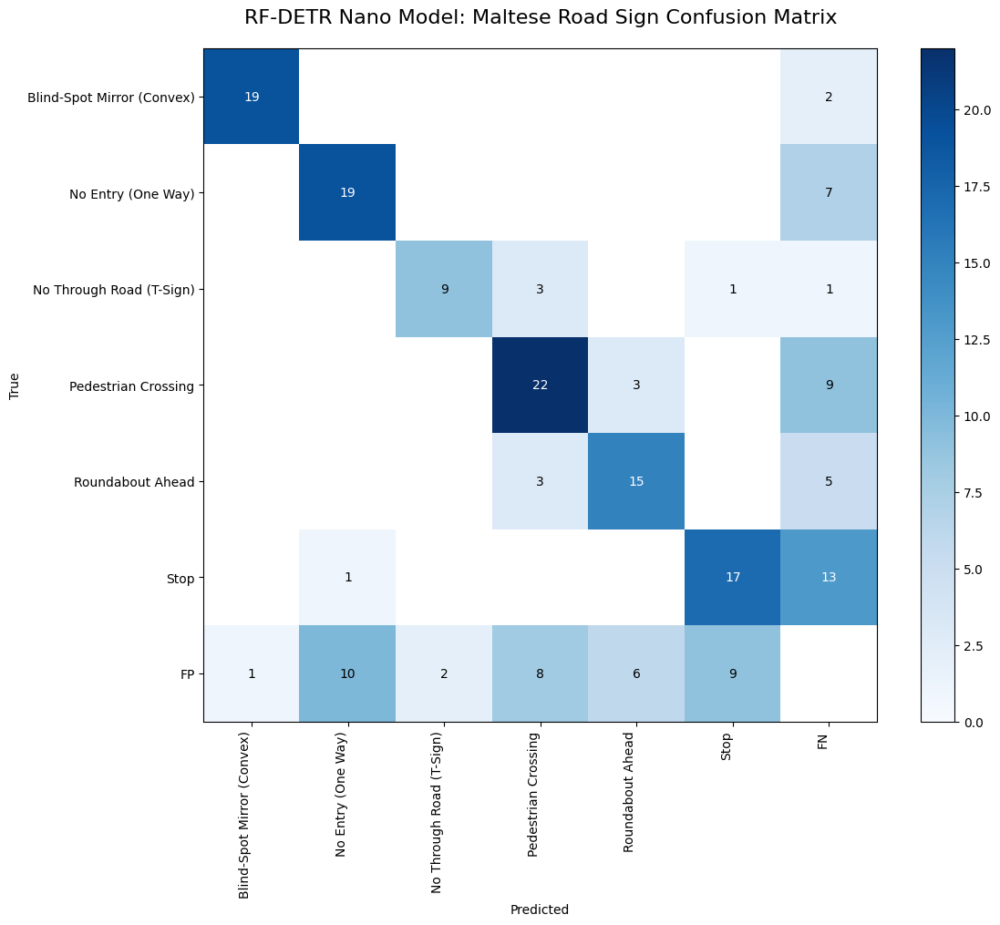

In [ ]:
import matplotlib.pyplot as plt

# Create the matrix
conf_matrix = sv.ConfusionMatrix.from_detections(
    predictions=predictions,
    targets=targets,
    classes=ds.classes
)

fig = conf_matrix.plot()
plt.title("RF-DETR Nano Model: Maltese Road Sign Confusion Matrix", fontsize=16, pad=20)
plt.tight_layout()
plt.show()

### Run Inference with Fine-tuned RF-DETR Model

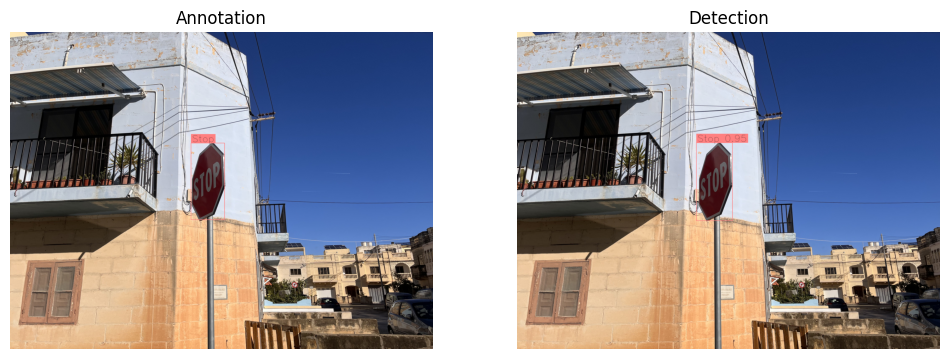

In [ ]:
from rfdetr import RFDETRBase
import supervision as sv
from PIL import Image

path, image, annotations = ds[5]
image = Image.open(path)

detections = model.predict(image, threshold=0.5)

text_scale = sv.calculate_optimal_text_scale(resolution_wh=image.size)
thickness = sv.calculate_optimal_line_thickness(resolution_wh=image.size)
color = sv.ColorPalette.from_hex([
    "#ffff00", "#ff9b00", "#ff66ff", "#3399ff", "#ff66b2", "#ff8080",
    "#b266ff", "#9999ff", "#66ffff", "#33ff99", "#66ff66", "#99ff00"
])

bbox_annotator = sv.BoxAnnotator(color=color,thickness=thickness)
label_annotator = sv.LabelAnnotator(
    color=color,
    text_color=sv.Color.BLACK,
    text_scale=text_scale)

annotations_labels = [
    f"{ds.classes[class_id]}"
    for class_id
    in annotations.class_id
]

detections_labels = [
    f"{ds.classes[class_id]} {confidence:.2f}"
    for class_id, confidence
    in zip(detections.class_id, detections.confidence)
]

annotation_image = image.copy()
annotation_image = bbox_annotator.annotate(annotation_image, annotations)
annotation_image = label_annotator.annotate(annotation_image, annotations, annotations_labels)

detections_image = image.copy()
detections_image = bbox_annotator.annotate(detections_image, detections)
detections_image = label_annotator.annotate(detections_image, detections, detections_labels)

sv.plot_images_grid(images=[annotation_image, detections_image], grid_size=(1, 2), titles=["Annotation", "Detection"])

### Seeing Where the Model Went Wrong

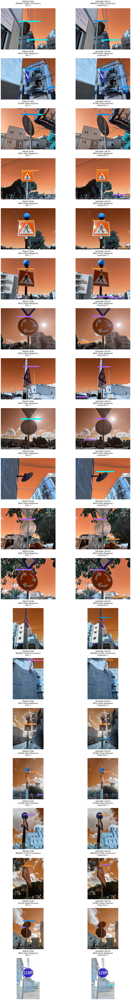

In [ ]:
from rfdetr import RFDETRNano
import supervision as sv
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Setup annotators
color = sv.ColorPalette.from_hex([
    "#ffff00", "#ff9b00", "#ff66ff", "#3399ff", "#ff66b2", "#ff8080",
    "#b266ff", "#9999ff", "#66ffff", "#33ff99", "#66ff66", "#99ff00"
])

images_to_show = []
titles_to_show = []
max_failures = 20

for path, image_np, annotations in ds:
    if len(images_to_show) >= max_failures * 2:  # *2 because we show pairs
        break

    # Run inference
    detections = model.predict(image_np, threshold=0.5)

    # Identify the specific error type
    if len(detections) < len(annotations):
        error_msg = "MISS (False Negative)"
    elif len(detections) > len(annotations):
        error_msg = "EXTRA (False Positive)"
    elif not np.array_equal(np.sort(detections.class_id), np.sort(annotations.class_id)):
        error_msg = "WRONG CLASS (Confusion)"
    else:
        continue  # Skip if correct

    # Calculate optimal annotation parameters
    text_scale = sv.calculate_optimal_text_scale(resolution_wh=(image_np.shape[1], image_np.shape[0]))
    thickness = sv.calculate_optimal_line_thickness(resolution_wh=(image_np.shape[1], image_np.shape[0]))

    bbox_annotator = sv.BoxAnnotator(color=color, thickness=thickness)
    label_annotator = sv.LabelAnnotator(
        color=color,
        text_color=sv.Color.BLACK,
        text_scale=text_scale
    )

    # Annotate PREDICTIONS (left image)
    pred_image = image_np.copy()
    pred_image = bbox_annotator.annotate(pred_image, detections)
    pred_image = label_annotator.annotate(
        pred_image,
        detections,
        [f"{ds.classes[c]} {conf:.2f}" for c, conf in zip(detections.class_id, detections.confidence)]
    )

    # Annotate GROUND TRUTH (right image)
    gt_image = image_np.copy()
    gt_image = bbox_annotator.annotate(gt_image, annotations)
    gt_labels = [f"{ds.classes[class_id]}" for class_id in annotations.class_id]
    gt_image = label_annotator.annotate(gt_image, annotations, gt_labels)

    # Add to display lists (predictions first, then ground truth)
    images_to_show.append(pred_image)
    images_to_show.append(gt_image)

    titles_to_show.append(f"PREDICTION\n{error_msg}\nGot: {len(detections)}")
    titles_to_show.append(f"GROUND TRUTH\n{error_msg}\nExpected: {len(annotations)}")

# Display images
num_pairs = len(images_to_show) // 2

# Create figure with larger size
fig, axes = plt.subplots(
    num_pairs, 2,
    figsize=(20, num_pairs * 6)
)

# Handle case where there's only 1 pair
if num_pairs == 1:
    axes = [axes]

# Plot each image
for idx, (img, title) in enumerate(zip(images_to_show, titles_to_show)):
    row = idx // 2
    col = idx % 2

    axes[row][col].imshow(img)
    axes[row][col].set_title(
        title,
        fontsize=16,          # Larger font size
        pad=20                # More padding between title and image
    )
    axes[row][col].axis('off')

# Adjust spacing
plt.subplots_adjust(
    hspace=0.4,   # Vertical spacing between rows (increase for more space)
    wspace=0.2,   # Horizontal spacing between columns
    top=0.95,     # Top margin
    bottom=0.05   # Bottom margin
)

plt.tight_layout()
plt.show()